# RECOMMEND AUDIO FEATURES

In [15]:
import pandas  as pd
import matplotlib.pyplot as plt

In [16]:
df_vn = pd.read_csv("datasets/vn_chart.csv")
df_glob = pd.read_csv("datasets/global_chart.csv")

In [17]:
df = pd.read_csv("datasets/audio_features.csv")

In [18]:
df.columns

Index(['id', 'danceability', 'energy', 'key', 'loudness', 'mode',
       'speechiness', 'acousticness', 'instrumentalness', 'liveness',
       'valence', 'tempo', 'duration_ms', 'time_signature', 'explicit',
       'popularity', 'release_date', 'album_id', 'album_name', 'track_number',
       'preview_url'],
      dtype='object')

In [27]:
pd.to_datetime(df['release_date']).dt.year.value_counts()

2023    1073
2022     338
2021      92
2020      89
2019      54
2017      40
2018      31
2016      28
2014      20
2010      11
2013      11
2015      11
2012      10
2011       8
2007       6
2004       5
2009       5
2000       4
2002       3
1984       3
1985       3
1993       3
1970       2
1977       2
2005       2
2003       2
2008       2
1981       1
1989       1
1983       1
1999       1
1991       1
1975       1
1979       1
1995       1
1978       1
1982       1
1980       1
1987       1
1976       1
1973       1
1990       1
1997       1
1998       1
1969       1
Name: release_date, dtype: int64

In [5]:
df = df.drop(columns=['popularity','release_date','album_id','album_name','track_number','preview_url'])

In [6]:
df.head()

,id,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,explicit
0,3rUGC1vUpkDG9CZFHMur1t,0.750,0.733,6,-3.180,0,0.0319,0.256,0.0000,0.114,0.844,111.018,131872,1,True
1,3xMHXmedL5Rvfxmiar9Ryv,0.575,0.845,0,-5.280,1,0.0852,0.393,0.0107,0.131,0.439,95.047,200374,4,False
2,2J6OF7CkpdQGSfm1wdclqn,0.583,0.344,2,-8.765,1,0.0559,0.774,0.0000,0.143,0.581,65.203,110129,3,True
3,3dYD57lRAUcMHufyqn9GcI,0.566,0.664,4,-5.303,0,0.0464,0.634,0.0000,0.116,0.437,128.945,241688,4,False
4,3vkCueOmm7xQDoJ17W1Pm3,0.504,0.308,9,-14.958,1,0.0321,0.868,0.1350,0.158,0.121,113.950,137773,4,False


Tương quan giữa 2 thị trường nhạc:

In [7]:
vn_songs = set(df_vn["track"])
glob_songs = set(df_glob["track"])

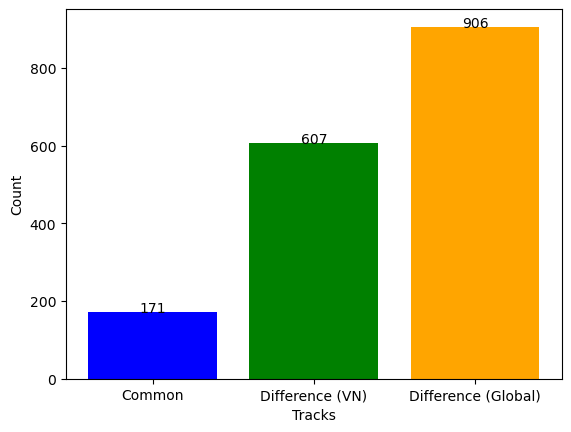

In [8]:
common_songs = len(vn_songs.intersection(glob_songs))

unique_vn_songs = len(vn_songs.difference(glob_songs))
unique_glob_songs = len(glob_songs.difference(vn_songs))

categories = ['Common', 'Difference (VN)', 'Difference (Global)']
counts = [common_songs, unique_vn_songs, unique_glob_songs]


plt.bar(categories, counts, color=['blue', 'green', 'orange'])
for i in range(len(categories)):
    plt.text(i, counts[i], str(counts[i]), ha='center')
plt.xlabel('Tracks')
plt.ylabel('Count')


plt.show()


Chia 2 thị trường riêng 

In [9]:
df_vn.dtypes

date        object
position     int64
id          object
track       object
artist      object
peak         int64
prev         int64
streak       int64
streams      int64
dtype: object

In [10]:
df_vn['date'] = pd.to_datetime(df_vn['date'])

In [11]:
df['explicit'] = df['explicit'].astype(int)

Phân cụm theo tháng để dự đoán được xu hướng 

Tháng 1:

In [12]:
df_vn_m = []

max_month = max(df_vn.date.dt.month)

for i in range(1,max_month+1):
    ids = set(df_vn[df_vn.date.dt.month== max_month]['id'])
    df_vn_m.append(df[df['id'].isin(ids)].copy())

In [13]:
from sklearn.manifold import TSNE
import plotly.express as px
import seaborn as sns

<frozen importlib._bootstrap>:228: RuntimeWarning: scipy._lib.messagestream.MessageStream size changed, may indicate binary incompatibility. Expected 56 from C header, got 64 from PyObject


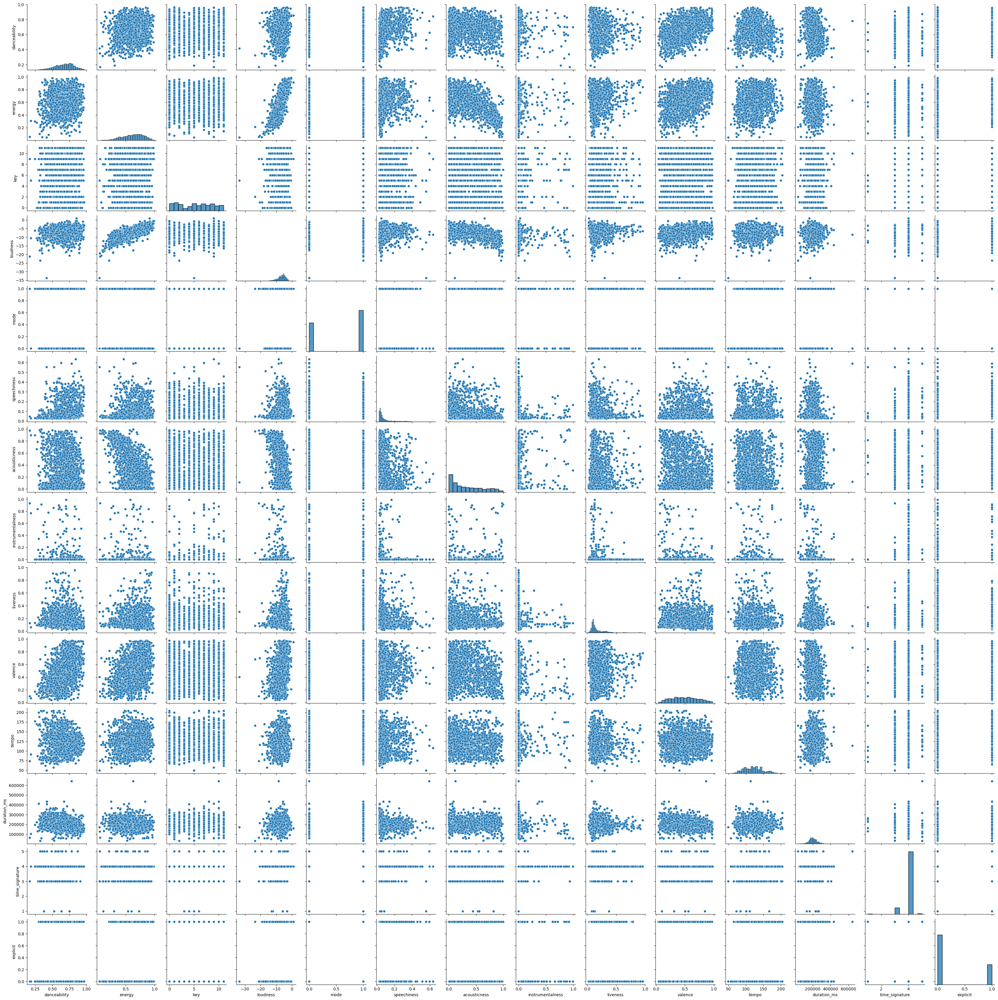

In [14]:
sns.pairplot(df)

C:\Users\tungb\anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
C:\Users\tungb\anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


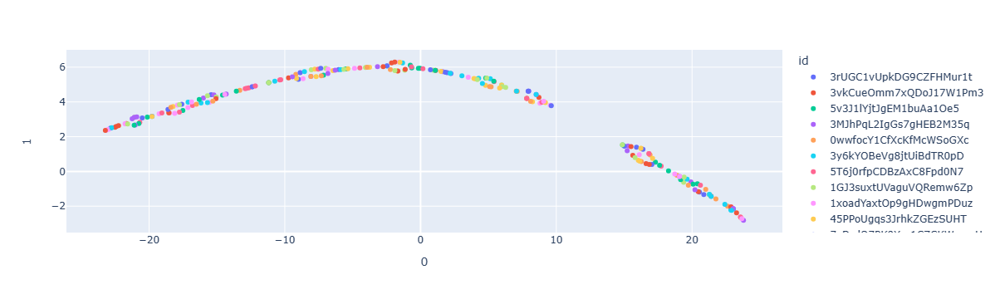

In [15]:
features = df_vn_m[0].drop(columns=['id']).values

tsne = TSNE(n_components=2, random_state=0)
projections = tsne.fit_transform(features)

fig = px.scatter(
    projections, x=0, y=1,
    color=df_vn_m[9].id, labels={'color': 'id'}
)
fig.show()

In [14]:
df.dtypes

id                   object
danceability        float64
energy              float64
key                   int64
loudness            float64
mode                  int64
speechiness         float64
acousticness        float64
instrumentalness    float64
liveness            float64
valence             float64
tempo               float64
duration_ms           int64
time_signature        int64
explicit              int32
dtype: object

In [17]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

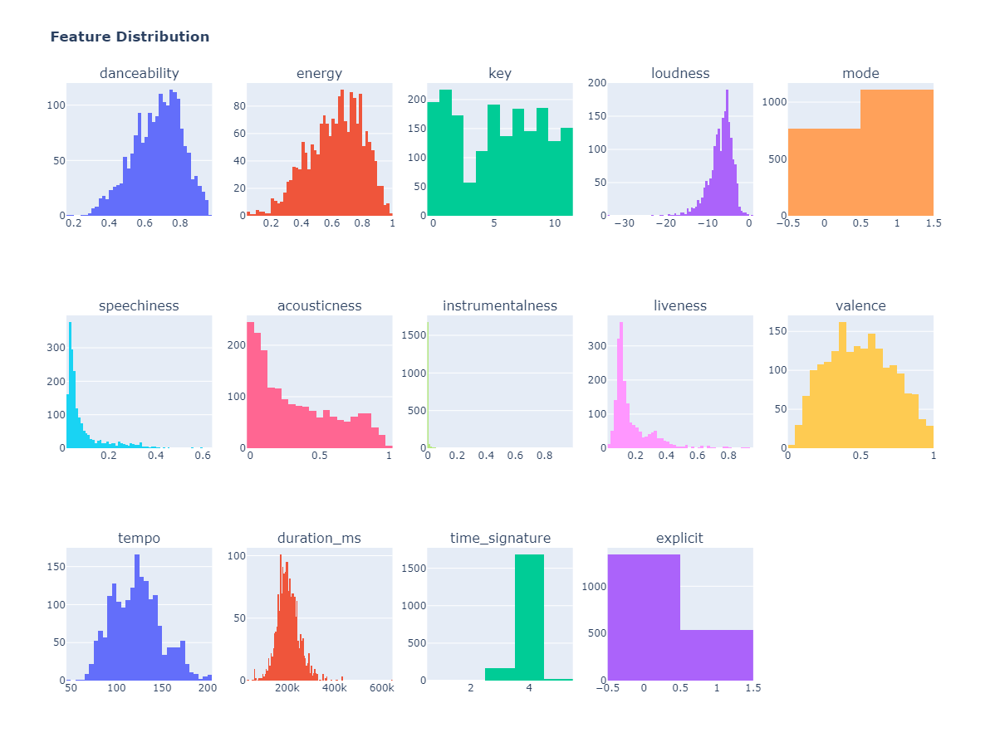

In [18]:
fig=make_subplots(rows=3,cols=5,subplot_titles=df.drop(columns='id').columns)
fig.add_trace(go.Histogram(x=df['danceability'],name='danceability'),row=1,col=1)
fig.add_trace(go.Histogram(x=df['energy'],name='energy'),row=1,col=2)
fig.add_trace(go.Histogram(x=df['key'],name='key'),row=1,col=3)
fig.add_trace(go.Histogram(x=df['loudness'],name='loudness'),row=1,col=4)
fig.add_trace(go.Histogram(x=df['mode'],name='mode'),row=1,col=5)
fig.add_trace(go.Histogram(x=df['speechiness'],name='speechiness'),row=2,col=1)
fig.add_trace(go.Histogram(x=df['acousticness'],name='acousticness'),row=2,col=2)
fig.add_trace(go.Histogram(x=df['instrumentalness'],name='instrumentalness'),row=2,col=3)
fig.add_trace(go.Histogram(x=df['liveness'],name='liveness'),row=2,col=4)
fig.add_trace(go.Histogram(x=df['valence'],name='valence'),row=2,col=5)
fig.add_trace(go.Histogram(x=df['tempo'],name='tempo'),row=3,col=1)
fig.add_trace(go.Histogram(x=df['duration_ms'],name='duration_ms'),row=3,col=2)
fig.add_trace(go.Histogram(x=df['time_signature'],name='time_signature'),row=3,col=3)
fig.add_trace(go.Histogram(x=df['explicit'],name='explicit'),row=3,col=4)
fig.update_layout(showlegend=False)
fig.update_layout(height=900,width=1100,title_text='<b>Feature Distribution')

In [19]:
df_vn_temp=df_vn.copy()

In [20]:
df_vn_temp['quarter'] = df_vn_temp['date'].dt.quarter

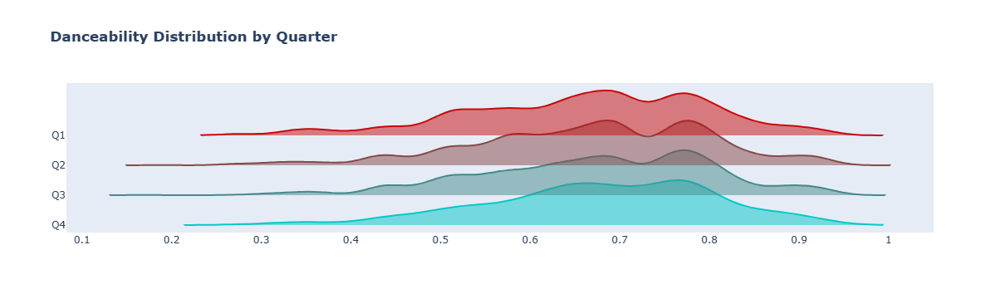

In [22]:
from plotly.colors import n_colors

colors = n_colors('rgb(5, 200, 200)', 'rgb(200, 10, 10)', 4, colortype='rgb')

fig = go.Figure()

quarter_labels = ['Q4', 'Q3', 'Q2', 'Q1']

for q, color, label in zip([4, 3, 2, 1], colors, quarter_labels):
    data = pd.merge(df_vn_temp[df_vn_temp.quarter == q], df, on='id', how='inner')['danceability']
    fig.add_trace(go.Violin(x=data, line_color=color, name=label))

fig.update_traces(orientation='h', side='positive', width=3, points=False)
fig.update_layout(xaxis_showgrid=False, xaxis_zeroline=False)

# Add legend
fig.update_layout(
    legend=dict(
        orientation="h",
        yanchor="bottom",
        y=1.02,
        xanchor="right",
        x=1
    )
)
fig.update_layout(showlegend=False)
fig.update_layout(title_text='<b>Danceability Distribution by Quarter')
fig.show()

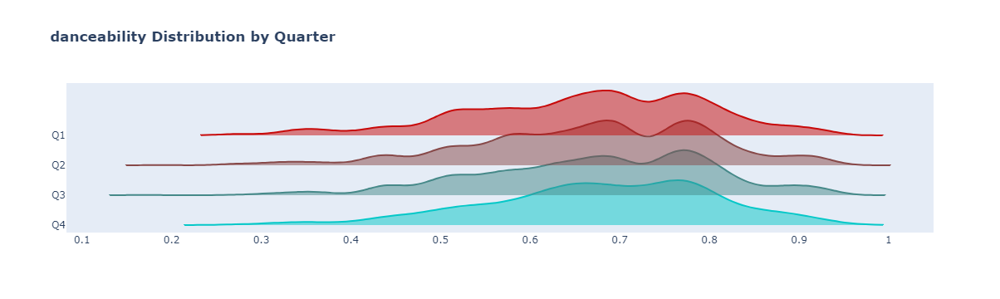

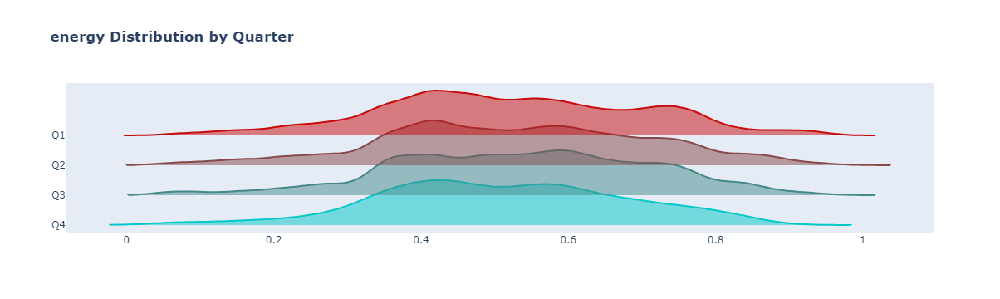

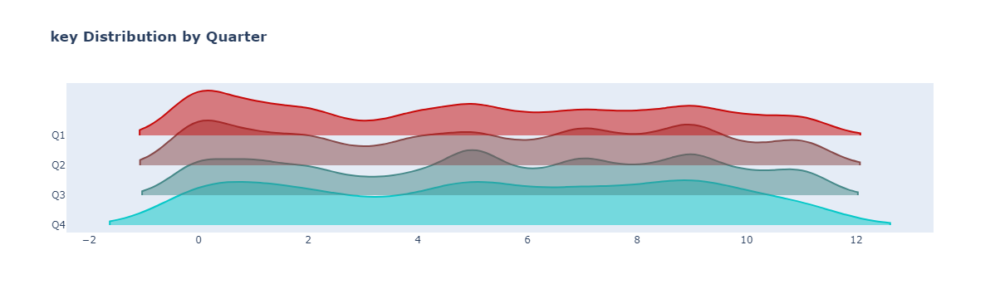

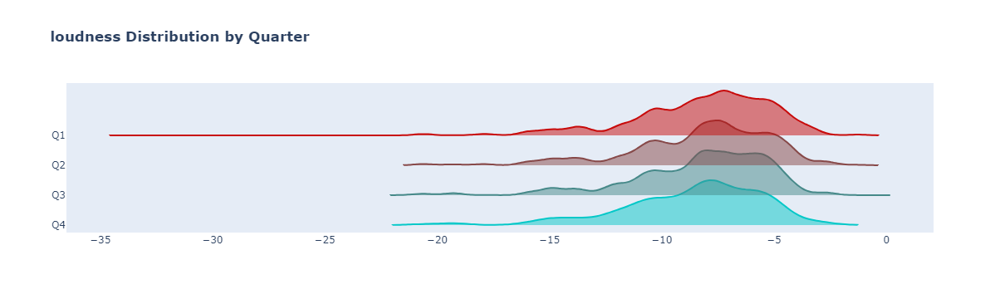

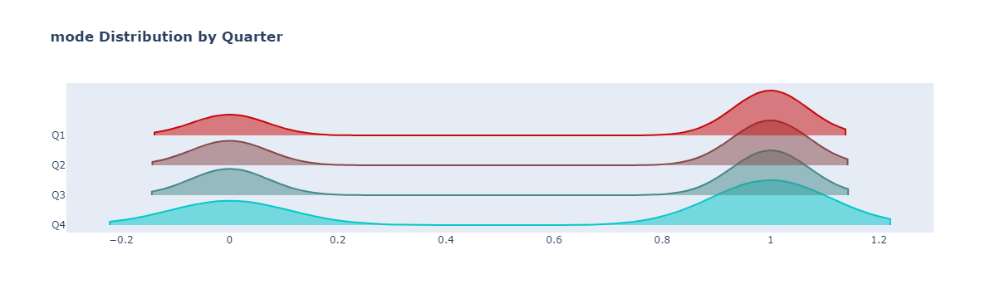

...

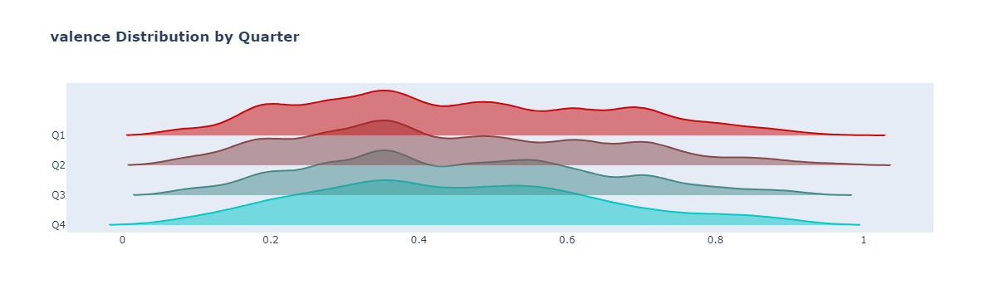

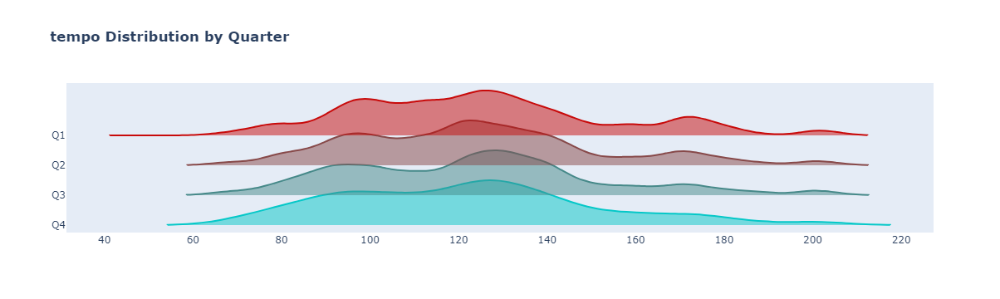

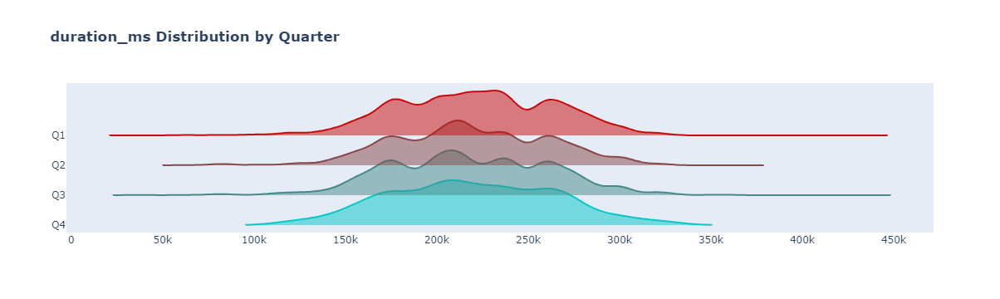

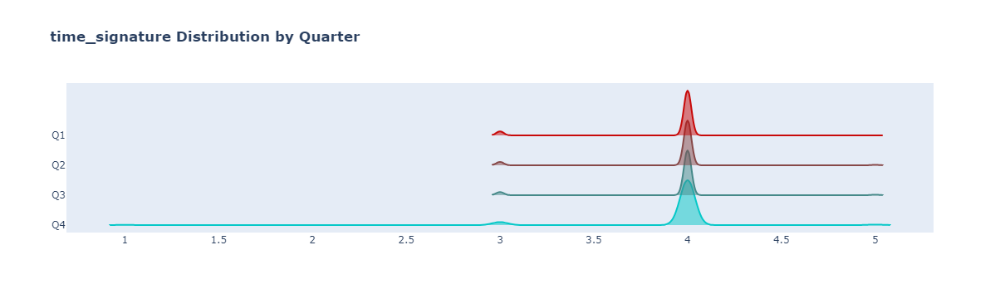

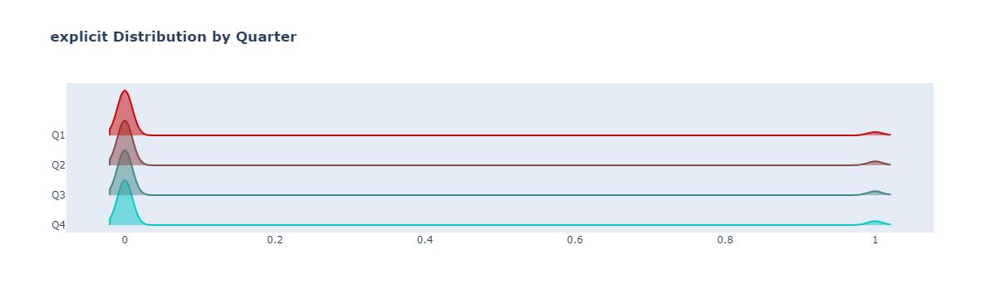

In [28]:
colors = n_colors('rgb(5, 200, 200)', 'rgb(200, 10, 10)', 4, colortype='rgb')

quarter_labels = ['Q4', 'Q3', 'Q2', 'Q1']

for feature in df.drop(columns=['id']).columns:
    fig = go.Figure()

    for q, color, label in zip([4, 3, 2, 1], colors, quarter_labels):
        data = pd.merge(df_vn_temp[df_vn_temp.quarter == q], df, on='id', how='inner')[feature]
        fig.add_trace(go.Violin(x=data, line_color=color, name=label))

    fig.update_traces(orientation='h', side='positive', width=3, points=False)
    fig.update_layout(xaxis_showgrid=False, xaxis_zeroline=False)

    # Add legend
    fig.update_layout(
        legend=dict(
            orientation="h",
            yanchor="bottom",
            y=1.02,
            xanchor="right",
            x=1
        )
    )
    fig.update_layout(showlegend=False)
    fig.update_layout(title_text=f'<b>{feature} Distribution by Quarter')
    fig.show()